# Matplotlib animation for fixed policy

>1. change grid to (10,10)
2. 3 blocks that cannot access
3. show fixed policy

## Step 1: 引入套件，設定好plt update function    

update function功能如下：
* 重新設置圓圈位置
* 清除原先的V[s]文字
* 將更新的V[s]文字繪製上去

In [40]:
import grid_world
import numpy as np
from grid_world import *
import random

In [41]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

def update_points(num):
    #更新數據點
    circle.center = (history[num][0]+0.5,history[num][1]+0.5)
    text_store[(history[num][0],history[num][1])].remove()
    text_store[(history[num][0],history[num][1])]=plt.text(history[num][0]+0.2, history[num][1]+0.2, V_history[num])
    if(num==len(history)-1):
        for i in range(grid.width):
            for j in range(grid.height):
                text_store[(i,j)].remove()
                text_store[(i,j)]=plt.text(i+0.2, j+0.2, 0.00)
    return circle,

## Step 2: 給定Grid World Fixed policy的參數，計算V[s]

In [42]:
grid = Grid(10, 10, (0, 0))            #設定width, height, start位置
rewards = {(8, 8): 1, (8, 6): -1}    #設定reward位置
actions = {                          #每個格子可以移動的方向
    (0, 0): ('D'), (0, 1): ('D'), (0, 2): ('R'), (0, 3): ('R'), (0, 4): ('D'), (0, 5): ('R'), (0, 6): ('R'), (0, 7): ('R'), (0, 8): ('R'), (0, 9): ('D'),
    (1, 0): ('D'), (1, 1): ('R'), (1, 2): ('U'), (1, 3): ('D'), (1, 4): ('L'), (1, 5): ('L'), (1, 6): ('R'), (1, 7): ('U'), (1, 8): ('D'), (1, 9): ('L'),
    (2, 0): ('D'), (2, 1): ('L'), (2, 2): ('L'), (2, 3): ('D'), (2, 4): ('R'), (2, 5): ('D'), (2, 6): ('D'), (2, 7): ('L'), (2, 8): ('R'), (2, 9): ('D'),
    (3, 0): ('D'), (3, 1): ('R'), (3, 2): ('R'), (3, 3): ('D'),                (3, 5): ('D'), (3, 6): ('D'), (3, 7): ('R'), (3, 8): ('U'), (3, 9): ('D'),
    (4, 0): ('D'), (4, 1): ('D'), (4, 2): ('L'), (4, 3): ('R'), (4, 4): ('R'), (4, 5): ('R'), (4, 6): ('R'), (4, 7): ('R'), (4, 8): ('D'), (4, 9): ('D'),
    (5, 0): ('D'), (5, 1): ('D'), (5, 2): ('U'), (5, 3): ('D'), (5, 4): ('D'), (5, 5): ('L'), (5, 6): ('L'),                (5, 8): ('D'), (5, 9): ('D'),
    (6, 0): ('D'), (6, 1): ('D'),                (6, 3): ('D'), (6, 4): ('D'), (6, 5): ('R'), (6, 6): ('R'), (6, 7): ('D'), (6, 8): ('D'), (6, 9): ('D'),
    (7, 0): ('R'), (7, 1): ('R'), (7, 2): ('R'), (7, 3): ('R'), (7, 4): ('R'), (7, 5): ('R'), (7, 6): ('R'), (7, 7): ('R'), (7, 8): ('D'), (7, 9): ('D'),
    (8, 0): ('U'), (8, 1): ('L'), (8, 2): ('U'), (8, 3): ('L'), (8, 4): ('L'), (8, 5): ('L'),                (8, 7): ('L'),                (8, 9): ('L'),
    (9, 0): ('R'), (9, 1): ('R'), (9, 2): ('R'), (9, 3): ('U'), (9, 4): ('R'), (9, 5): ('R'), (9, 6): ('U'), (9, 7): ('U'), (9, 8): ('U'), (9, 9): ('L'),
}

grid.set(rewards, actions)           #把rewards和actions存入grid中
states = grid.all_states()

In [43]:
#initialize V, gamma, policy, grid
v = {}
gamma = 0.9
small_enough = 1e-3
for s in states:
    v[s] = 0
history=[]
V_history=[]

while True:
    biggest_change = 0.0
    for s in states:                     #s會得到(0, 1)、(1, 2)...等state
        old_v = v[s]
        new_v = 0
        if s in grid.actions.keys():
            a = grid.actions[s]          #a會得到D,L,R或U
            grid.set_state(s)            #i,j會變成s所在的格子
            r = grid.move(a)             #i,j的數字會隨前進方向改變，r會收到回傳的reward值
            new_v = r + gamma * v[grid.current_state()]
            history.append(s)
            V_history.append(round(new_v,2))
        v[s] = round(new_v,5)
        biggest_change = max(biggest_change, np.abs(old_v - new_v))
    if biggest_change < small_enough:
        break
        
for i in range(grid.width):
    print("-----------------------------------------------------------")
    for j in range(grid.height):
        V = v.get((i,j), 0)
        if V >= 0:
            print(" %.2f|" % V, end="")
        else:
            print("%.2f|" % V, end="") # -ve sign takes up an extra space
    print("")

-----------------------------------------------------------
 0.21| 0.15| 0.21| 0.23| 0.25| 0.23| 0.25| 0.28| 0.31| 0.35|
-----------------------------------------------------------
 0.23| 0.17| 0.19| 0.31| 0.28| 0.25| 0.23| 0.25| 0.43| 0.39|
-----------------------------------------------------------
 0.25| 0.23| 0.21| 0.35| 0.39| 0.43| 0.48| 0.43| 0.48| 0.53|
-----------------------------------------------------------
 0.28| 0.31| 0.35| 0.39| 0.00| 0.48| 0.53| 0.39| 0.43| 0.59|
-----------------------------------------------------------
 0.31| 0.35| 0.31| 0.43| 0.48| 0.53| 0.59| 0.66| 0.73| 0.66|
-----------------------------------------------------------
 0.35| 0.39| 0.28| 0.48| 0.53| 0.48| 0.43| 0.00| 0.81| 0.73|
-----------------------------------------------------------
 0.39| 0.43| 0.00| 0.53| 0.59| 0.66| 0.73| 0.81| 0.90| 0.81|
-----------------------------------------------------------
 0.43| 0.48| 0.53| 0.59| 0.66| 0.73| 0.81| 0.90| 1.00| 0.90|
--------------------------------

## Step 3:用matplotlib繪製動畫，顯示計算V[s]的過程
### 紅色代表reward為1，黃色代表reward為-1，綠色代表無法進入

Animation size has reached 20990364 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


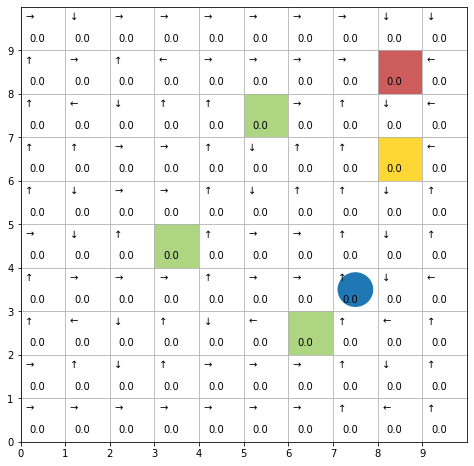

In [44]:
#這個指令可以讓圖形不會在新視窗呈現
%matplotlib inline

#畫好格線
fig, ax=plt.subplots(figsize=(8,8))
plt.xlim(0, 10)
plt.ylim(0, 10)
plt.grid(axis="x")
plt.grid(axis="y")
plt.xticks(np.arange(0, 10, 1))
plt.yticks(np.arange(0, 10, 1))

#格子上色
x1 = [8, 9, 9, 8]
y1 = [8, 8, 9, 9]
x2 = [8, 8, 9, 9]
y2 = [6, 7, 7, 6]
plt.fill(x1, y1, "#CD5C5C", x2, y2, "#FDD835")
plt.fill([6,7,7,6], [2,2,3,3], "#AED581")
plt.fill([3,4,4,3], [4,4,5,5], "#AED581")
plt.fill([5,6,6,5], [7,7,8,8], "#AED581")

circle= plt.Circle((0.5,9.5), radius= 0.4)
ax.add_patch(circle)

text_store={}

for i in range(grid.width):
    #print("------------------------------------------------------------")
    for j in range(grid.height):
        a = actions.get((i,j), ' ')
        #print("  %s  |" %a[0], end="")
        #格子內加上方向
        if a=='D':
            plt.text(i+0.1, j+0.7, "→", fontsize=10)
        elif a=='U':
            plt.text(i+0.1, j+0.7, "←", fontsize=10)
        elif a=='L':
            plt.text(i+0.1, j+0.7, "↓", fontsize=10)
        elif a=='R':
            plt.text(i+0.1, j+0.7, "↑", fontsize=10)
        text_store[(i,j)]=plt.text(i+0.2, j+0.2, 0.00)
    #print("")

ani = animation.FuncAnimation(fig, update_points, np.arange(0, len(history)), interval=100, blit=False)

#plt.show()
HTML(ani.to_jshtml())

### 額外附上grid_ani.py，是可以運作動畫到結束的python程式，以下是執行完動畫的成果圖：
![title](result.png)